# Running and analyzing an EXP simulation using pyEXP from a notebook: collapse in a periodic cube

We will assume that you are running the Docker EXP image.  If not, make sure that you `pip install k3d` for the final three-dimensional
rendering.

We begin by importing `pyEXP` and friends and setting the working directory.

In [1]:
import os
import yaml
import pyEXP
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [12, 9]

# Move to Cube directory
os.chdir('Cube')

# Print the current working directory for reference
print(os.getcwd())

# Clean up any previous run
for f in os.listdir('data'):
    os.remove(os.path.join('data', f))

/home/weinberg/Projects/pyEXP-examples/Tutorials/EXP/Cube


## Running EXP

If you have a full EXP install or are using the Docker image, you can run EXP from inside Jupyter to generate new simulations.  We'll do
and example here using the periodic cube.

### Generating initial conditions

The full install has a body generator for the cube called `cubeics`.  Try it as follows:

In [2]:
! cubeics -h

Cube IC generator with uniform spatial and normal velocities.  You may specify a bulk velocity and anisotropic dispersion vector.
Usage:
  cubeics [OPTION...]

  -h, --help        Print this help message
  -z, --zerovel     Zero the mean velocity
  -N, --number arg  Number of particles to generate (default: 100000)
  -M, --mass arg    Total mass of the cube (default: 1.0)
  -d, --disp arg    Velocity dispersion triple
  -v, --bulk arg    Bulk velocity triple
  -s, --seed arg    Random number seed. Default: use /dev/random
  -o, --file arg    Output body file (default: cube.bods)
  -w, --wave arg    Perturbation wave vector
  -p, --pamp arg    Perturbation amplitude




We can generate some initial conditions for `N=20000` bodies for an isotropic velocity dispersion tensor as follows:

In [3]:
! cubeics -N 20000 -z -d 0.1,0.3,0.5 -o cube.bods

We have provided a sample `exp` configuration file in this working directory.  The default name for a configuration file is
`config.yml`.  This run will take under an hour; and as little as 10 minutes on a modern laptop.  So be prepared to take a short
break.  For maximum speed change `X` in the `-np X` argument to `mpirun` to the number of cores available in your CPU.

The `exp` launch command is:

In [4]:
%%time
! mpirun exp

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

#   Node name           PID         Executable                              
-   ---------           ---         ----------                              
0   raven               221503      exp                                     
1   raven               221504      exp                                     
2   raven               221505      exp                                     
3   raven               221506      exp                                     
4   raven               221507      exp                                     
5   raven               221508      exp                                     
6   raven               221509      exp                                     
7   raven               221510      exp                                     
8   raven               221511      exp                                     
9   raven               221514      exp                                

## Reading the cube coefficients
This is a test of the coefficients created by the `EXP-examples/Cube` run.

In [5]:
# Reread the coefs from the file.  These are new HDF5 coefficients sets.
#
coefs = pyEXP.coefs.Coefs.factory('data/outcoef.cube.run0')

print("Got coefs for name=", coefs.getName())

Got coefs for name= cube


## Now get the time vector and data tensor. Plot some coefficient series as a function of time.

In [6]:

times = coefs.Times()
data  = coefs.getAllCoefs()
nx, ny, nz, ntimes = data.shape
nmaxx = int((nx - 1)/2)
nmaxy = int((ny - 1)/2)
nmaxz = int((nz - 1)/2)

print("The data sizes and coefficient orders are:")
print(data.shape[0], data.shape[1], data.shape[2], nmaxx, nmaxy, nmaxz)

The data sizes and coefficient orders are:
17 17 17 8 8 8


### Finally, plot some coefficient values...

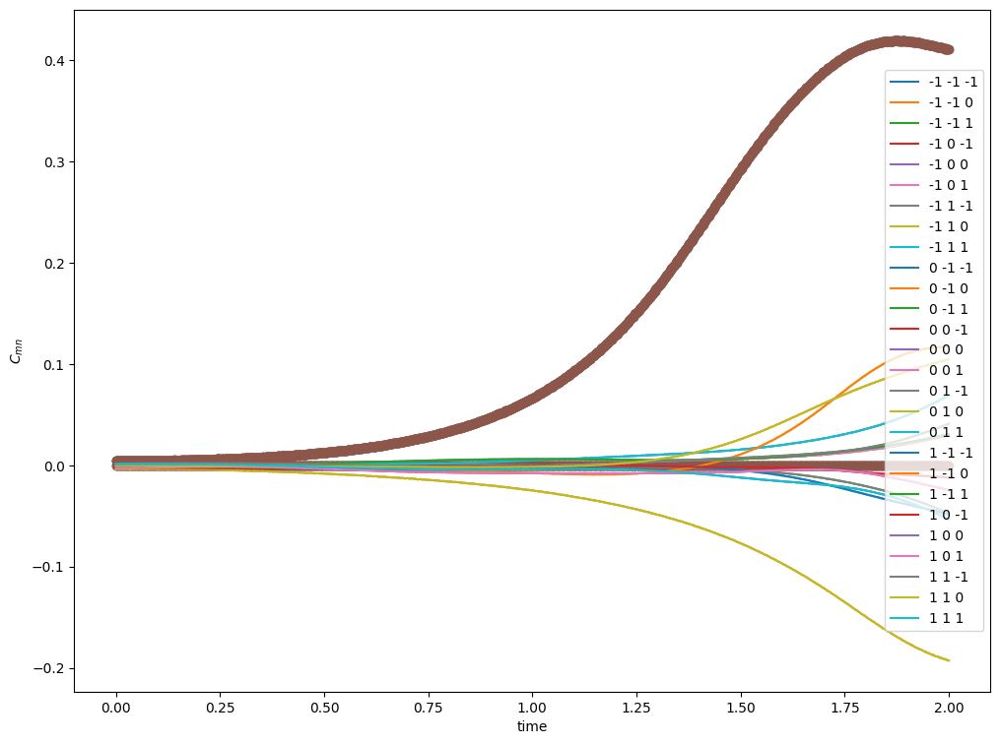

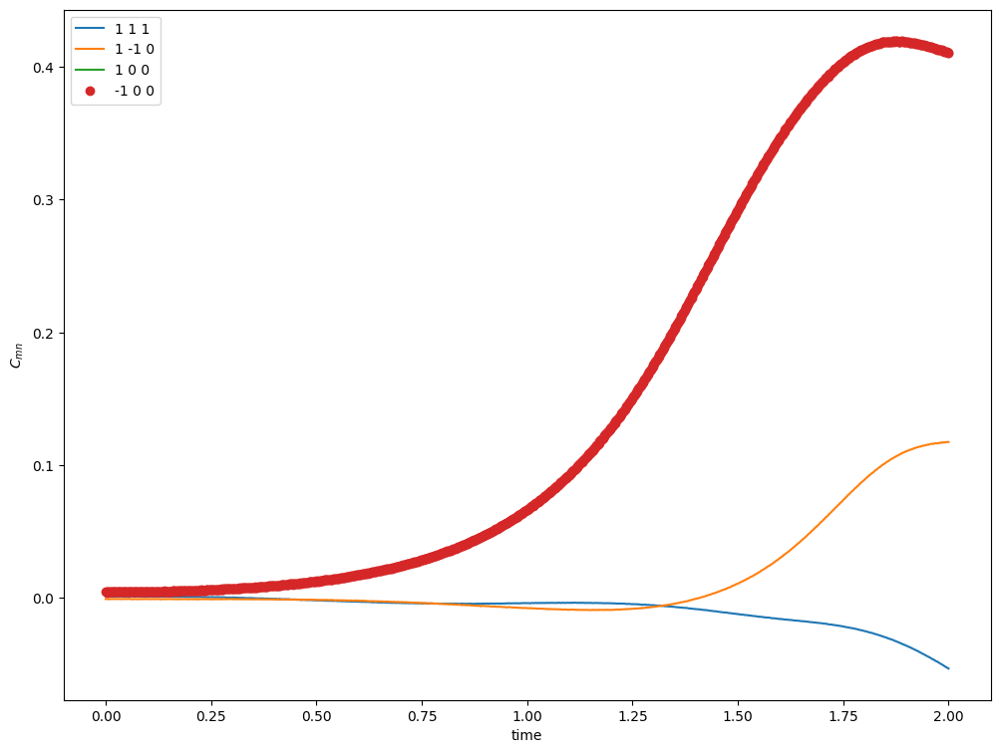

In [7]:
for i in range(nmaxx-1, nmaxx+2):
    for j in range(nmaxy-1, nmaxy+2):
        for k in range(nmaxz-1, nmaxz+2):
            plt.plot(times, np.real(data[i, j, k, :]), label='{} {} {}'.format(i-nmaxx, j-nmaxy, k-nmaxz))
            if j==nmaxy and k==nmaxz:
                plt.plot(times, np.real(data[i, j, k, :]), 'o')

plt.xlabel('time')
plt.ylabel(r'$C_{mn}$')
plt.legend()
plt.show()

plt.plot(times, np.real(data[nmaxx+1, nmaxy+1, nmaxz+1, :]), '-', label='{} {} {}'.format(1, 1, 1))
plt.plot(times, np.real(data[nmaxx+1, nmaxy-1, nmaxz, :]), '-', label='{} {} {}'.format(1, -1, 0))
plt.plot(times, np.real(data[nmaxx+1, nmaxy, nmaxz, :]), '-', label='{} {} {}'.format(1, 0, 0))
plt.plot(times, np.real(data[nmaxx-1, nmaxy, nmaxz, :]), 'o', label='{} {} {}'.format(-1, 0, 0))
plt.xlabel('time')
plt.ylabel(r'$C_{mn}$')
plt.legend()
plt.show()

## Try loading EXP config with pyYAML

In [8]:
with open('config.yml', 'r') as f:
    yaml_db = yaml.load(f, Loader=yaml.FullLoader)

In [9]:
# There is only one component here at index = 0

config = yaml.dump(yaml_db['Components'][0]['force'])
        
print(config)

id: cube
parameters:
  nmaxx: 8
  nmaxy: 8
  nmaxz: 8



## Construct the cube basis

In [10]:
basis = pyEXP.basis.Basis.factory(config)

In [11]:
times = coefs.Times()

In [12]:
# Slice through the cube perpendicular to the z axis
rmin  = 0.0
rmax  = 1.0
pmin  = [ rmin, rmin, 0.5]
pmax  = [ rmax, rmax, 0.5]
grid  = [   40,    40,  0]

fields = pyEXP.field.FieldGenerator(times, pmin, pmax, grid)

surfaces = fields.slices(basis, coefs)

In [13]:
import math

def getLim(x):
    """ Get the one signifcant figure upper/lower limit """
    om = 10.0**np.floor(np.log10(np.abs(x)))
    if x < 0.0:
        return (np.floor(x/om)*om, om)
    else:
        return (np.ceil(x/om)*om, om)

In [14]:
densmin =  1.0e30
densmax = -1.0e30

for v in surfaces:
    for k in surfaces[v]: 
        # print(v, k)
        if k=='dens m>0':
            densmin = min(densmin, np.min(surfaces[v]['dens m>0']))
            densmax = max(densmax, np.max(surfaces[v]['dens m>0']))

print('Density range', densmin, densmax)

Density range -1.9601362 17.810572


## Slice through the cube perpendicular to the z axis and render

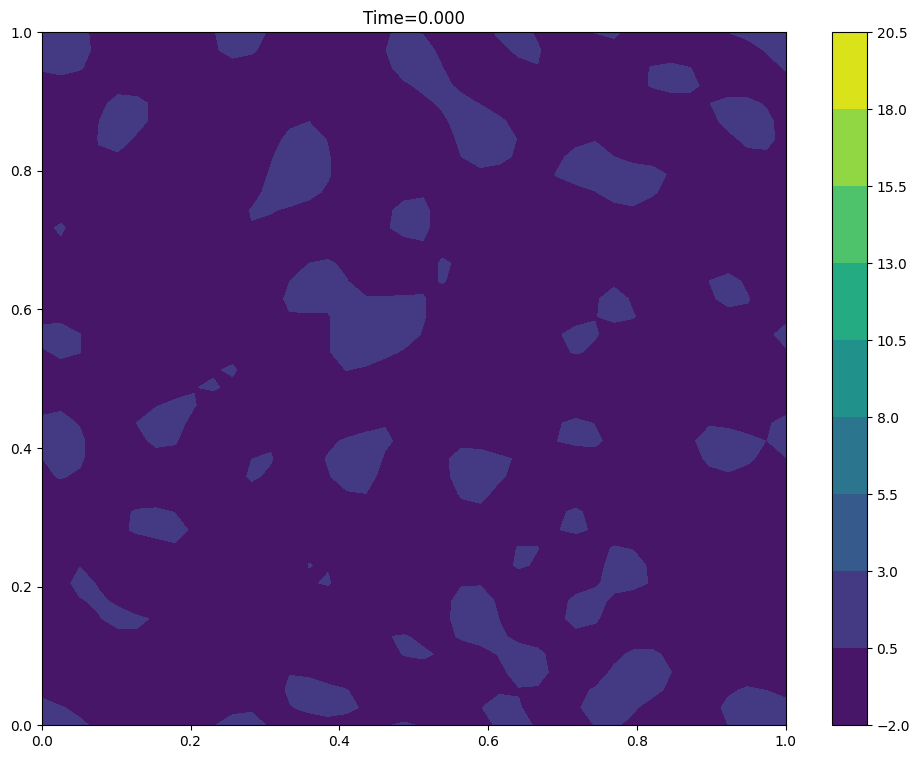

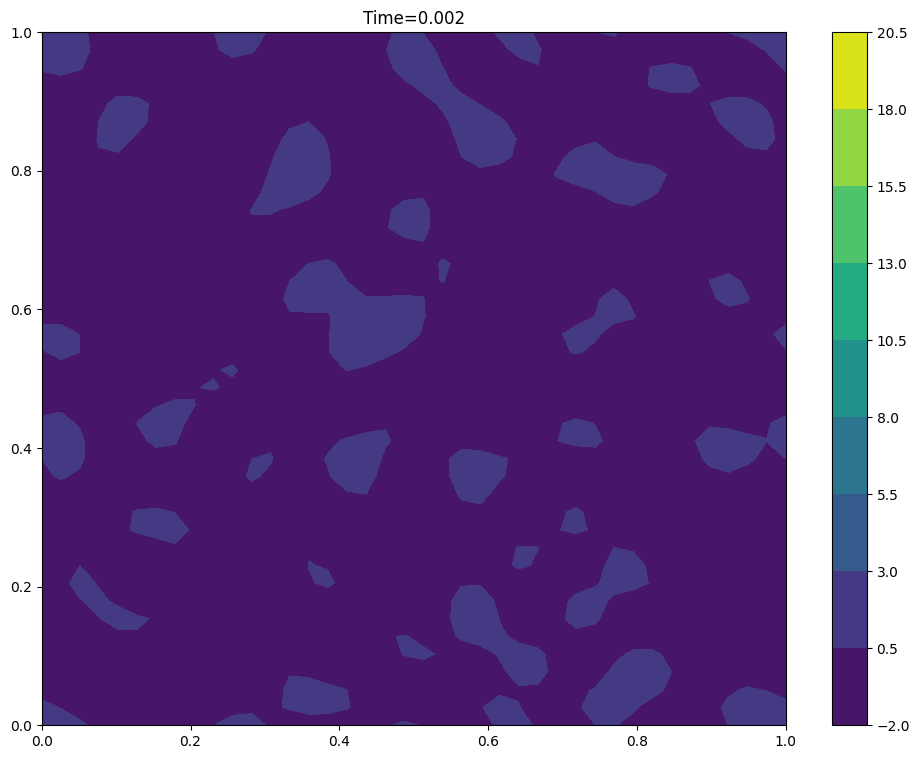

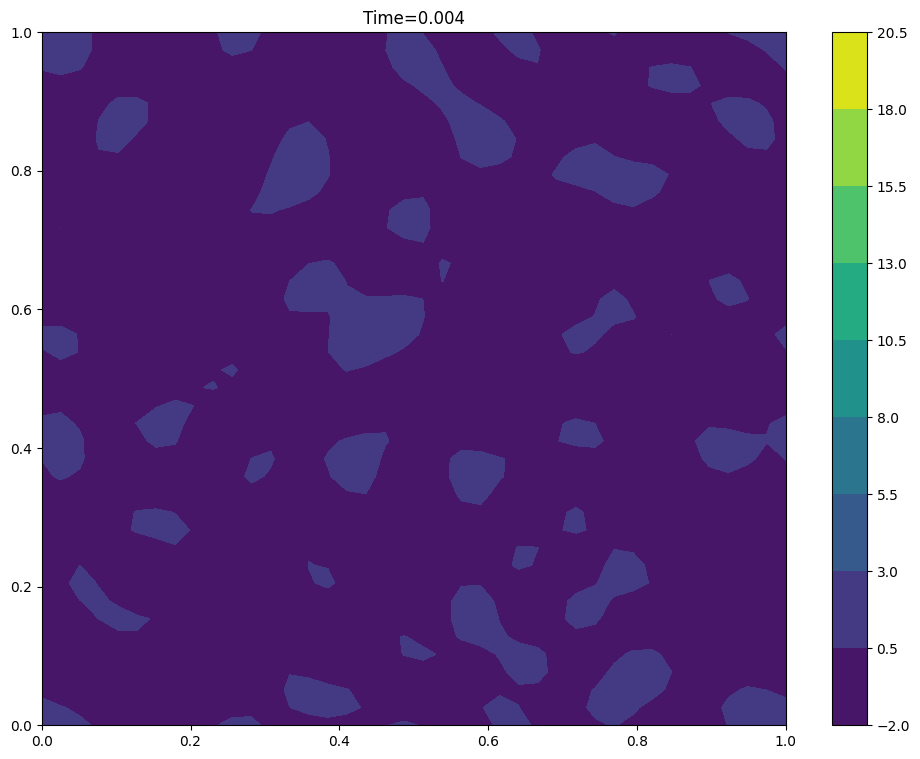

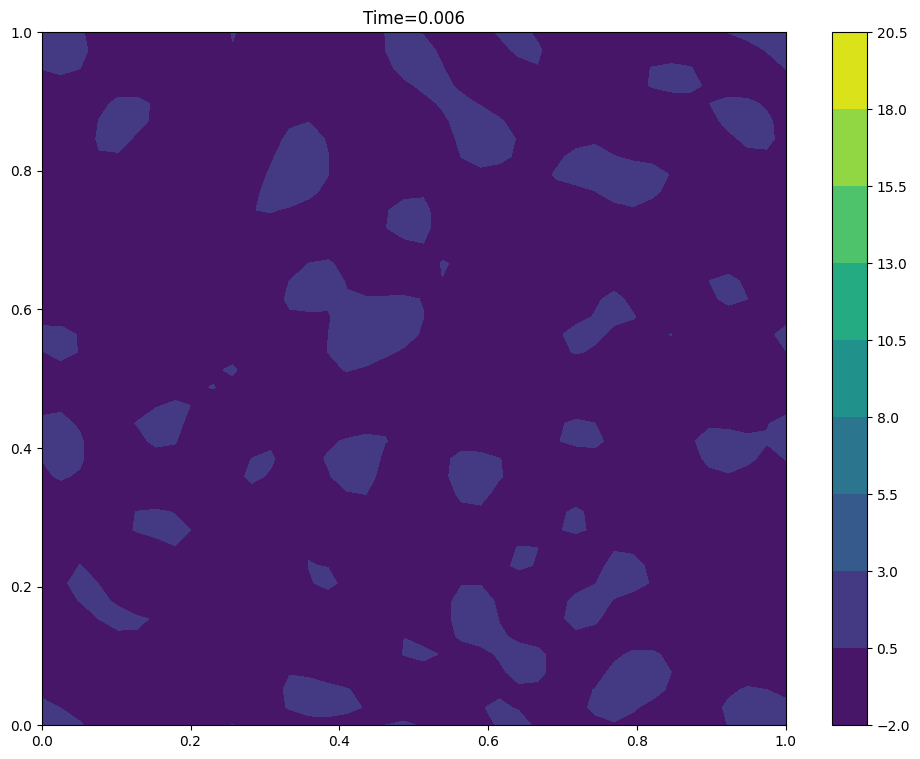

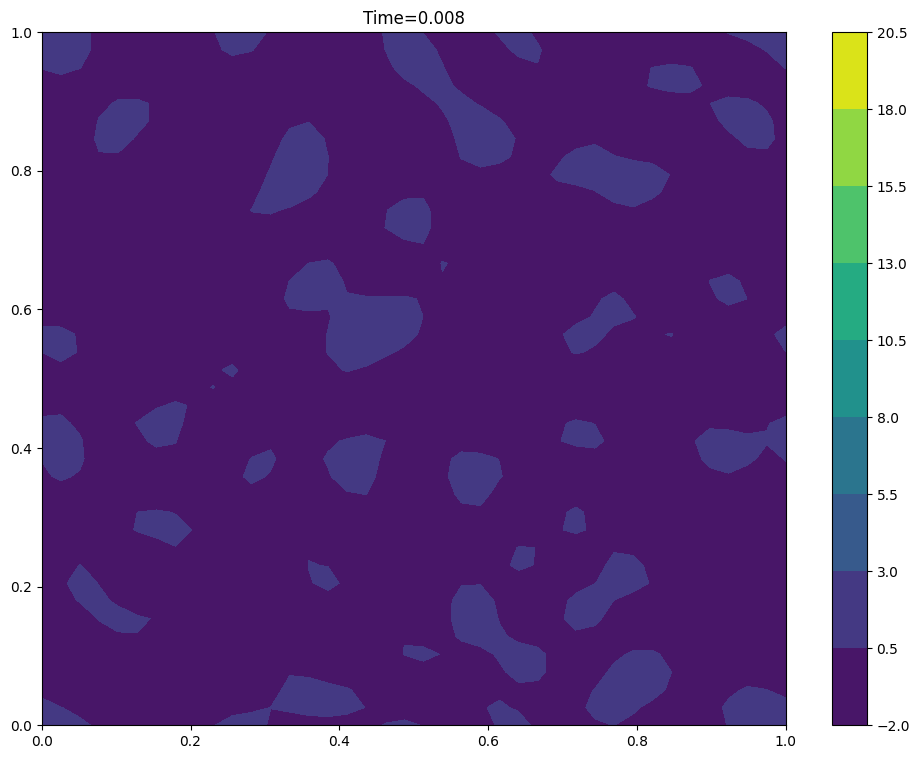

...

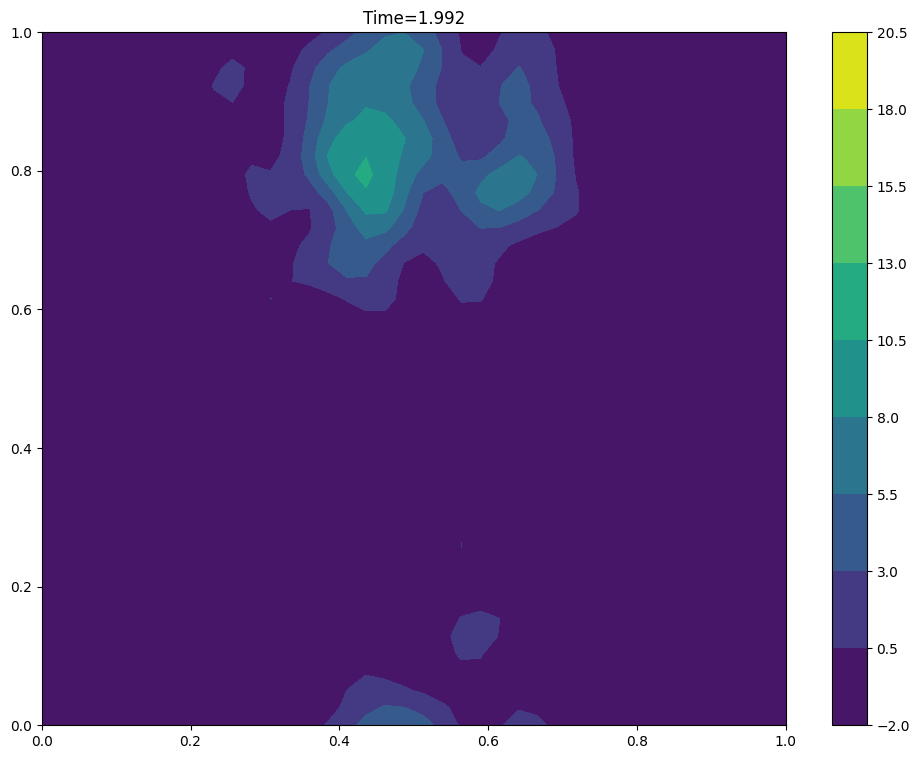

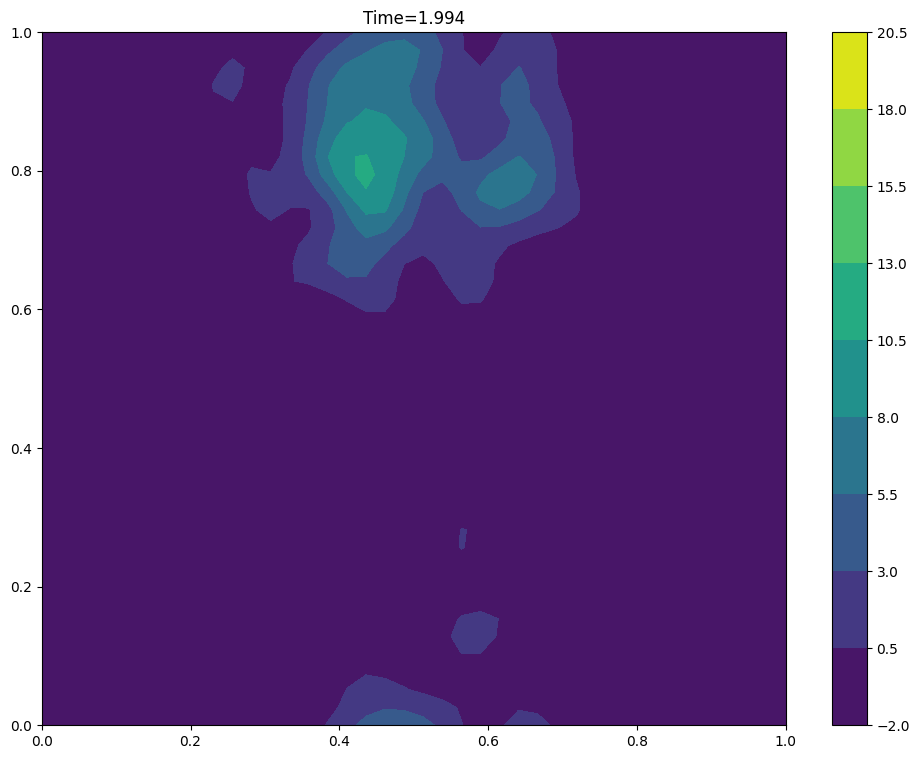

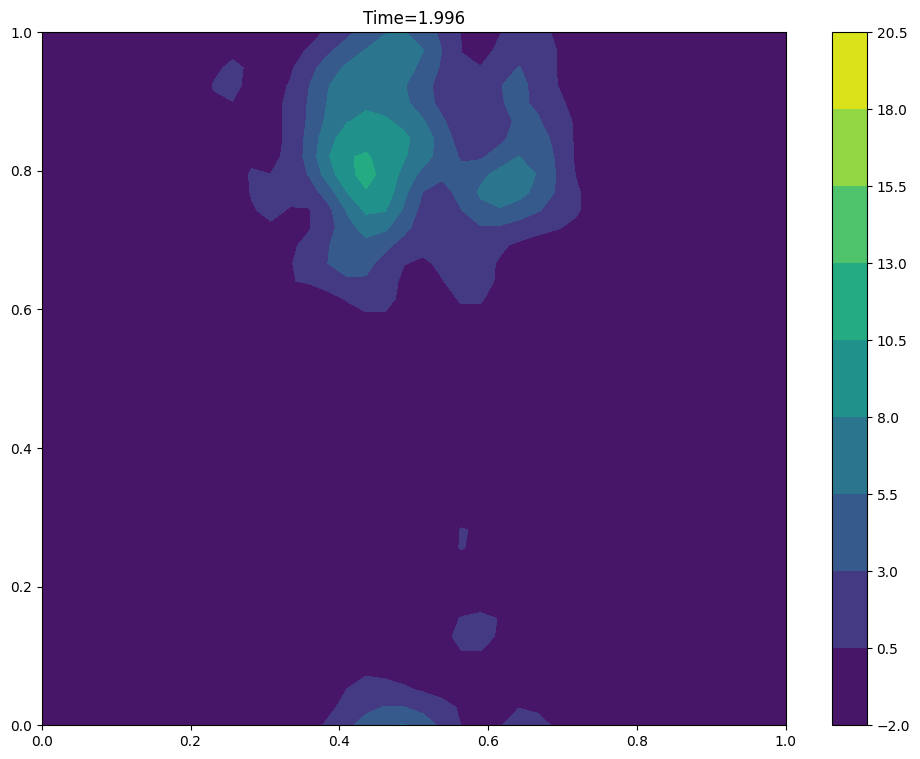

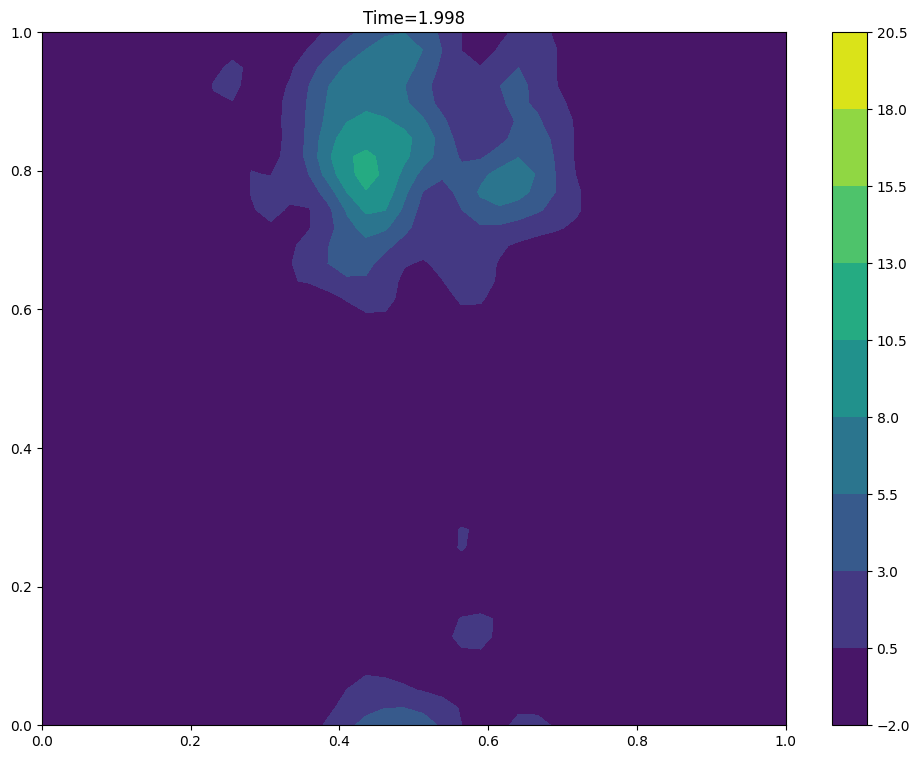

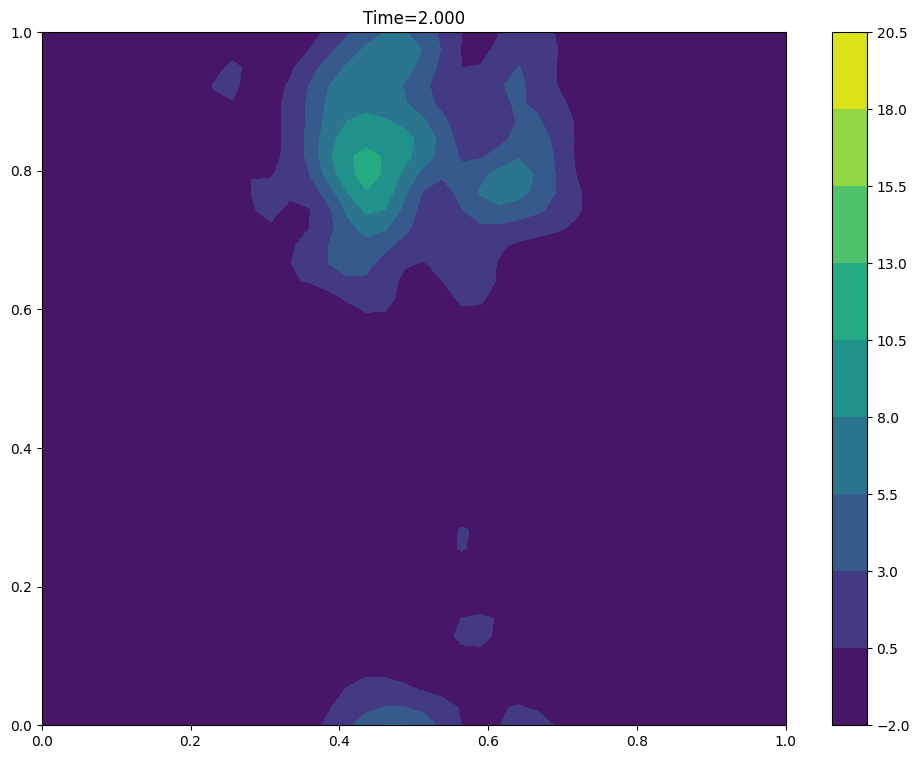

In [15]:
# Get the evaluation grid
dr = (rmax-rmin)/(40-1)
rr = np.arange(rmin, rmax+0.1*dr, dr)
xv, yv = np.meshgrid(rr, rr)
cnt = 0

# Round to one sig figfor v in surfaces:
dmin, ommin = getLim(densmin)
dmax, ommax = getLim(densmax)
drange = max(ommin, ommax)*0.25

# Make levels
levs = np.arange(dmin, dmax+0.5*drange, drange)
for v in times:
    cc = plt.contourf(xv, yv, surfaces[v]['dens m>0'].transpose(), levels=levs)
    plt.colorbar(cc)
    plt.title('Time={:4.3f}'.format(v))
    plt.savefig('cube_{:04d}.png'.format(cnt))
    cnt += 1
    plt.show()

### A few comments

The velocity dispersion values chosen for the initial conditions are Jeans unstable.  They will produce a sheet, tube, and blob-like instability.  The sheet will be hard to see with our small number of particles.  You can always decide to rerun the simulation with
more particles, if you like.

The following few cells constructs a three-dimensional density rendering of the final time frame.

### A 3d rendering for fun

In [16]:
import k3d
from k3d import matplotlib_color_maps

# Slice through the cube perpendicular to the z axis
rmin  = 0.0
rmax  = 1.0
pmin  = [ rmin, rmin, rmin]
pmax  = [ rmax, rmax, rmax]
grid  = [   40,   40,   40]

# Only render the final time
fields = pyEXP.field.FieldGenerator(times[-1:], pmin, pmax, grid)

volumes = fields.volumes(basis, coefs)

In [17]:
# levels for renderng 
drange = min(ommin, ommax)*5
levs = np.arange(dmin, dmax+0.5*drange, drange)
print("Level surfaces:", levs)

Level surfaces: [-2.  3.  8. 13. 18.]


In [18]:
plot = k3d.plot(axes=['z', 'y', 'x'])
color_map = k3d.basic_color_maps.Jet

minlev = dmin
maxlev = dmax

for lev in levs:
    plot += k3d.marching_cubes(volumes[times[-1]]['dens m>0'], level=lev, attribute=[lev], color_map=color_map, color_range=[minlev, maxlev],
                            opacity=0.25,
                            xmin=rmin, xmax=rmax,
                            ymin=rmin, ymax=rmax,
                            zmin=rmin, zmax=rmax,
                            compression_level=9,
                            flat_shading=False)
plot.display()
plot.camera = [-0.35, -0.8, 1.5, 0.5, 0.5, 0.5, 0, 0, 1]



Output()

***

## Where do you want to go next?

- [Return to Table of Contents](../README.ipynb)
- [Back to previous notebook](disk%20halo.ipynb)
- [Go to next notebook](zang%20disk.ipynb)
